In [1]:
# basic library import section
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import warnings
warnings.filterwarnings('ignore')

In [2]:
# import required datasets
train = pd.read_csv('../input/tabular-playground-series-jul-2021/train.csv')
test = pd.read_csv('../input/tabular-playground-series-jul-2021/test.csv')
sample_sub = pd.read_csv('../input/tabular-playground-series-jul-2021/sample_submission.csv')

In [3]:
train.shape, test.shape

((7111, 12), (2247, 9))

In [4]:
train.head()

,date_time,deg_C,relative_humidity,absolute_humidity,sensor_1,sensor_2,sensor_3,sensor_4,sensor_5,target_carbon_monoxide,target_benzene,target_nitrogen_oxides
0,2010-03-10 18:00:00,13.1,46.0,0.7578,1387.2,1087.8,1056.0,1742.8,1293.4,2.5,12.0,167.7
1,2010-03-10 19:00:00,13.2,45.3,0.7255,1279.1,888.2,1197.5,1449.9,1010.9,2.1,9.9,98.9
2,2010-03-10 20:00:00,12.6,56.2,0.7502,1331.9,929.6,1060.2,1586.1,1117.0,2.2,9.2,127.1
3,2010-03-10 21:00:00,11.0,62.4,0.7867,1321.0,929.0,1102.9,1536.5,1263.2,2.2,9.7,177.2
4,2010-03-10 22:00:00,11.9,59.0,0.7888,1272.0,852.7,1180.9,1415.5,1132.2,1.5,6.4,121.8


In [5]:
#Let's print a concise summary of train Dataset
train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7111 entries, 0 to 7110
Data columns (total 12 columns):
 #   Column                  Non-Null Count  Dtype  
---  ------                  --------------  -----  
 0   date_time               7111 non-null   object 
 1   deg_C                   7111 non-null   float64
 2   relative_humidity       7111 non-null   float64
 3   absolute_humidity       7111 non-null   float64
 4   sensor_1                7111 non-null   float64
 5   sensor_2                7111 non-null   float64
 6   sensor_3                7111 non-null   float64
 7   sensor_4                7111 non-null   float64
 8   sensor_5                7111 non-null   float64
 9   target_carbon_monoxide  7111 non-null   float64
 10  target_benzene          7111 non-null   float64
 11  target_nitrogen_oxides  7111 non-null   float64
dtypes: float64(11), object(1)
memory usage: 666.8+ KB


In [6]:
# now print a concise summary of test Dataset
test.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2247 entries, 0 to 2246
Data columns (total 9 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   date_time          2247 non-null   object 
 1   deg_C              2247 non-null   float64
 2   relative_humidity  2247 non-null   float64
 3   absolute_humidity  2247 non-null   float64
 4   sensor_1           2247 non-null   float64
 5   sensor_2           2247 non-null   float64
 6   sensor_3           2247 non-null   float64
 7   sensor_4           2247 non-null   float64
 8   sensor_5           2247 non-null   float64
dtypes: float64(8), object(1)
memory usage: 158.1+ KB


In [7]:
# descriptive statistics of train set
train.describe().T.style.bar(subset=['mean'], color='#606ff2').background_gradient(subset=['std'],cmap='YlOrBr').bar(subset=['max'],color='green')

,count,mean,std,min,25%,50%,75%,max
deg_C,7111.000000,20.878034,7.937917,1.300000,14.900000,20.700000,25.800000,46.100000
relative_humidity,7111.000000,47.561004,17.398731,8.900000,33.700000,47.300000,60.800000,90.800000
absolute_humidity,7111.000000,1.110309,0.398950,0.198800,0.855900,1.083500,1.404150,2.231000
sensor_1,7111.000000,1091.572100,218.537554,620.300000,930.250000,1060.500000,1215.800000,2088.300000
sensor_2,7111.000000,938.064970,281.978988,364.000000,734.900000,914.200000,1124.100000,2302.600000
sensor_3,7111.000000,883.903305,310.456355,310.600000,681.050000,827.800000,1008.850000,2567.400000
sensor_4,7111.000000,1513.238349,350.180310,552.900000,1320.350000,1513.100000,1720.400000,2913.800000
sensor_5,7111.000000,998.335565,381.537695,242.700000,722.850000,928.700000,1224.700000,2594.600000
target_carbon_monoxide,7111.000000,2.086219,1.447109,0.100000,1.000000,1.700000,2.800000,12.500000
target_benzene,7111.000000,10.237083,7.694426,0.100000,4.500000,8.500000,14.200000,63.700000


In [8]:
# descriptive statistics of test set
test.describe().T.style.bar(subset=['mean'], color='#606ff2').background_gradient(subset=['std'],cmap='YlOrBr').bar(subset=['max'],color='green')

,count,mean,std,min,25%,50%,75%,max
deg_C,2247.000000,10.808144,6.444497,-1.800000,5.600000,9.800000,14.200000,30.900000
relative_humidity,2247.000000,51.031242,16.665047,9.800000,36.900000,50.600000,63.550000,88.800000
absolute_humidity,2247.000000,0.627053,0.266588,0.184700,0.413350,0.596400,0.804950,1.393000
sensor_1,2247.000000,1106.534490,205.341455,665.900000,951.500000,1080.400000,1222.100000,1882.900000
sensor_2,2247.000000,836.459769,272.816585,356.200000,640.700000,800.800000,1016.100000,1776.100000
sensor_3,2247.000000,828.321495,339.511779,320.100000,597.050000,757.100000,944.950000,1975.000000
sensor_4,2247.000000,1104.850601,293.112225,523.400000,899.450000,1076.200000,1288.350000,2211.400000
sensor_5,2247.000000,1029.851535,434.863287,218.800000,688.550000,973.100000,1324.000000,2593.800000


In [9]:
# checking null values
print(train.isna().sum())
print("============================")
print(test.isna().sum())

date_time                 0
deg_C                     0
relative_humidity         0
absolute_humidity         0
sensor_1                  0
sensor_2                  0
sensor_3                  0
sensor_4                  0
sensor_5                  0
target_carbon_monoxide    0
target_benzene            0
target_nitrogen_oxides    0
dtype: int64
date_time            0
deg_C                0
relative_humidity    0
absolute_humidity    0
sensor_1             0
sensor_2             0
sensor_3             0
sensor_4             0
sensor_5             0
dtype: int64


In [10]:
# features to visualize
new_train = train.drop(['date_time','target_carbon_monoxide', 'target_benzene', 'target_nitrogen_oxides'], axis = 1)
new_test = test.drop('date_time', axis = 1)
features= ['deg_C', 'relative_humidity', 'absolute_humidity', 'sensor_1', 'sensor_2', 'sensor_3', 'sensor_4', 'sensor_5']
targets = ['target_carbon_monoxide', 'target_benzene', 'target_nitrogen_oxides']

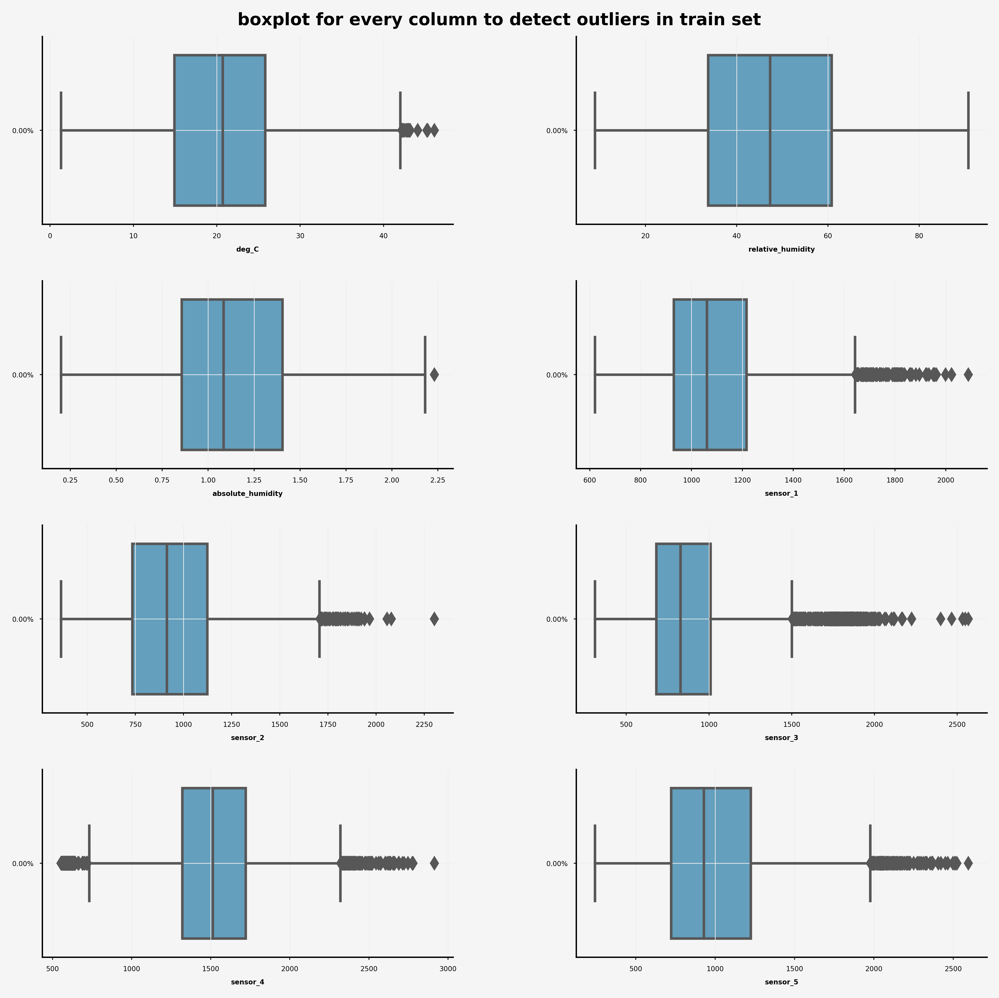

In [11]:
import matplotlib.ticker as ticker
from matplotlib.ticker import PercentFormatter

plt.rcParams['figure.dpi'] = 600
fig = plt.figure(figsize=(10, 10), facecolor='#f6f5f5')
gs = fig.add_gridspec(4, 2)
gs.update(wspace=0.3, hspace=0.3)

background_color = "#f6f5f5"
sns.set_palette('icefire')

run_no = 0
for row in range(0, 4):
    for col in range(0, 2):
        locals()["ax"+str(run_no)] = fig.add_subplot(gs[row, col])
        locals()["ax"+str(run_no)].set_facecolor(background_color)
        for s in ["top","right"]:
            locals()["ax"+str(run_no)].spines[s].set_visible(False)
        run_no += 1

features = list(new_train.columns) 

run_no = 0
for col in features:
    sns.boxplot(ax=locals()["ax"+str(run_no)],x=col, data = new_train)
    locals()["ax"+str(run_no)].grid(which='major', axis='x', zorder=0, color='#EEEEEE', linewidth=0.4)
    locals()["ax"+str(run_no)].grid(which='major', axis='y', zorder=0, color='#EEEEEE', linewidth=0.4)
    locals()["ax"+str(run_no)].set_ylabel('')
    locals()["ax"+str(run_no)].set_xlabel(col, fontsize=4, fontweight='bold')
    locals()["ax"+str(run_no)].tick_params(labelsize=4, width=0.5, length=1.5)
    locals()["ax"+str(run_no)].yaxis.set_major_formatter(ticker.PercentFormatter())
    run_no += 1
fig.text(0.5, 0.9, 'boxplot for every column to detect outliers in train set', fontsize=10, ha='center', va='top', weight='bold')
plt.show()

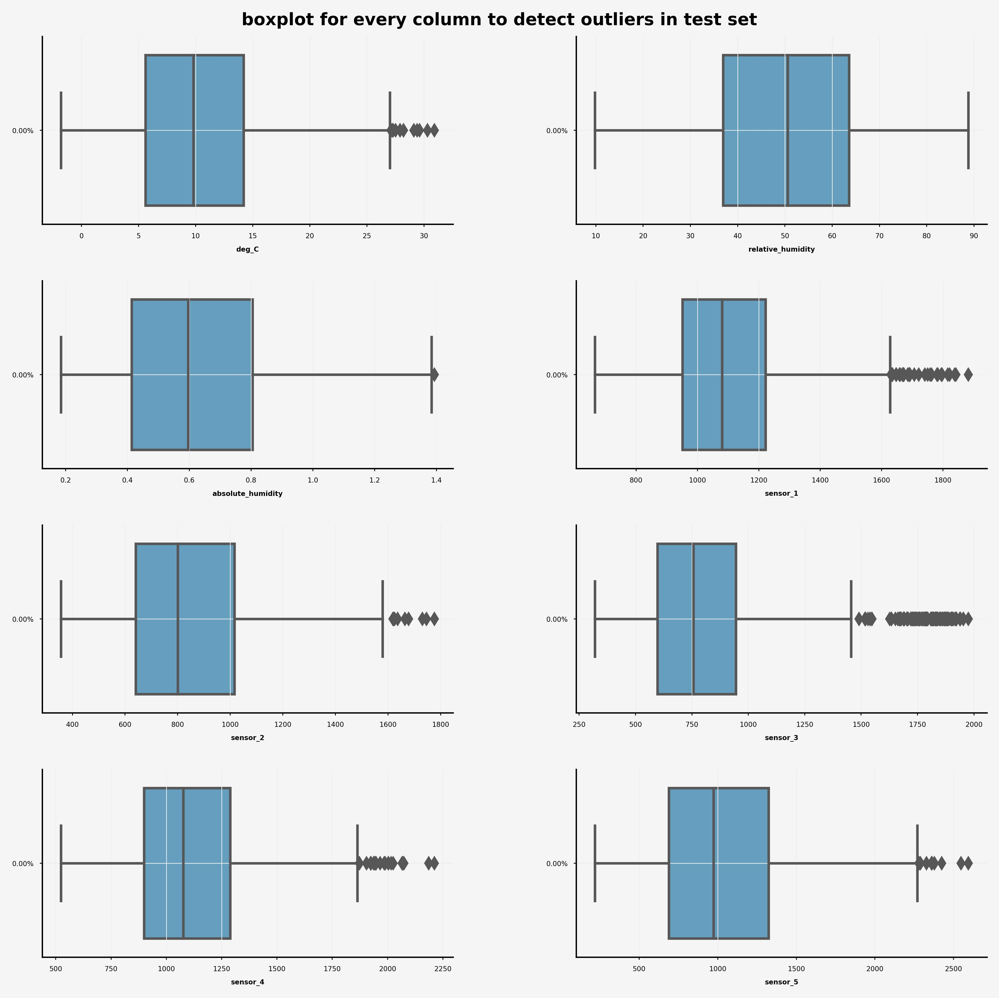

In [12]:
fig = plt.figure(figsize=(10, 10), facecolor='#f6f5f5')
gs = fig.add_gridspec(4, 2)
gs.update(wspace=0.3, hspace=0.3)

background_color = "#f6f5f5"
sns.set_palette('icefire')
run_no = 0
for row in range(0, 4):
    for col in range(0, 2):
        locals()["ax"+str(run_no)] = fig.add_subplot(gs[row, col])
        locals()["ax"+str(run_no)].set_facecolor(background_color)
        for s in ["top","right"]:
            locals()["ax"+str(run_no)].spines[s].set_visible(False)
        run_no += 1

features = list(new_test.columns) 

run_no = 0
for col in features:
    sns.boxplot(ax=locals()["ax"+str(run_no)],x=col, data = new_test)
    locals()["ax"+str(run_no)].grid(which='major', axis='x', zorder=0, color='#EEEEEE', linewidth=0.4)
    locals()["ax"+str(run_no)].grid(which='major', axis='y', zorder=0, color='#EEEEEE', linewidth=0.4)
    locals()["ax"+str(run_no)].set_ylabel('')
    locals()["ax"+str(run_no)].set_xlabel(col, fontsize=4, fontweight='bold')
    locals()["ax"+str(run_no)].tick_params(labelsize=4, width=0.5, length=1.5)
    locals()["ax"+str(run_no)].yaxis.set_major_formatter(ticker.PercentFormatter())
    run_no += 1
fig.text(0.5, 0.9, 'boxplot for every column to detect outliers in test set', fontsize=10, ha='center', va='top', weight='bold')
plt.show()

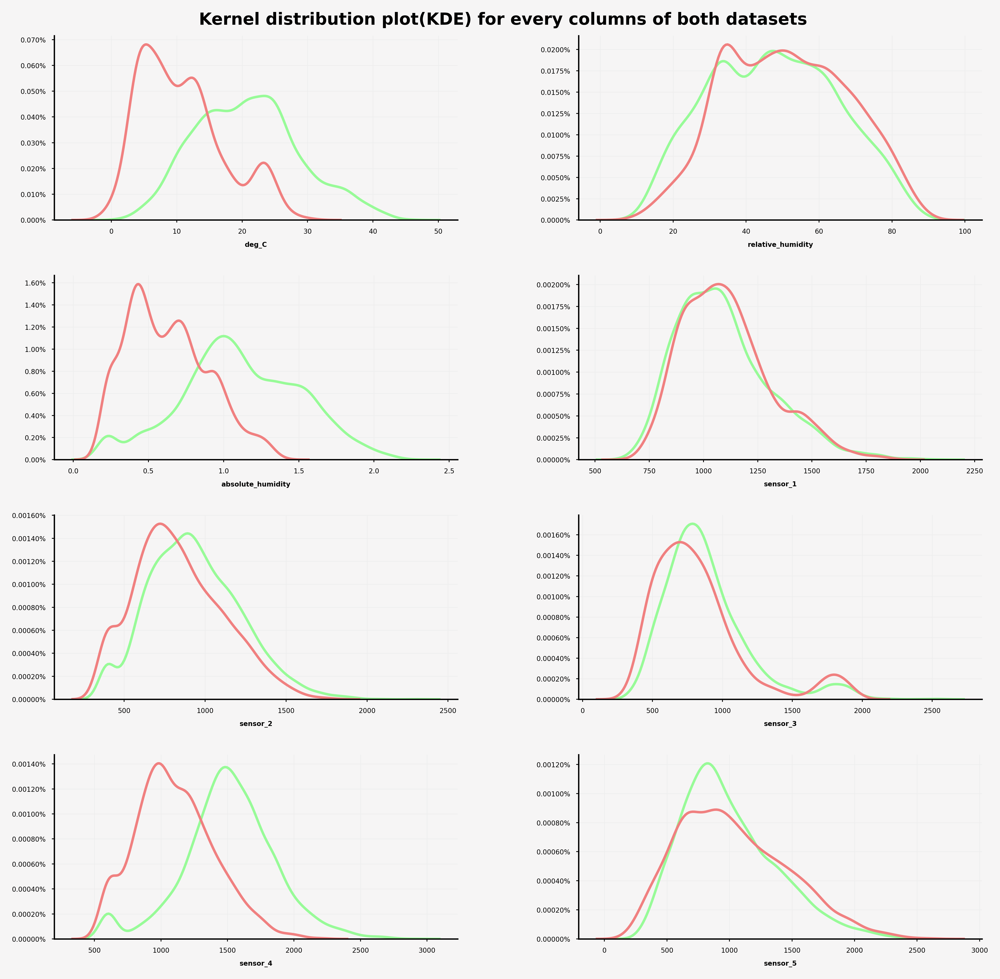

In [13]:
plt.rcParams['figure.dpi'] = 600
fig = plt.figure(figsize=(10, 10), facecolor='#f6f5f5')
gs = fig.add_gridspec(4, 2)
gs.update(wspace=0.3, hspace=0.3)

background_color = "#f6f5f5"
sns.set_palette('icefire')

run_no = 0
for row in range(0, 4):
    for col in range(0, 2):
        locals()["ax"+str(run_no)] = fig.add_subplot(gs[row, col])
        locals()["ax"+str(run_no)].set_facecolor(background_color)
        for s in ["top","right"]:
            locals()["ax"+str(run_no)].spines[s].set_visible(False)
        run_no += 1

features = list(new_train.columns) 

run_no = 0
for col in features:
    sns.kdeplot(ax=locals()["ax"+str(run_no)],x=col, data = new_train, color = 'palegreen')
    sns.kdeplot(ax=locals()["ax"+str(run_no)],x=col, data = new_test, color = 'lightcoral')
    locals()["ax"+str(run_no)].grid(which='major', axis='x', zorder=0, color='#EEEEEE', linewidth=0.4)
    locals()["ax"+str(run_no)].grid(which='major', axis='y', zorder=0, color='#EEEEEE', linewidth=0.4)
    locals()["ax"+str(run_no)].set_ylabel('')
    locals()["ax"+str(run_no)].set_xlabel(col, fontsize=4, fontweight='bold')
    locals()["ax"+str(run_no)].tick_params(labelsize=4, width=0.5, length=1.5)
    locals()["ax"+str(run_no)].yaxis.set_major_formatter(ticker.PercentFormatter())
    run_no += 1
fig.text(0.5, 0.9, 'Kernel distribution plot(KDE) for every columns of both datasets', fontsize=10, ha='center', va='top', weight='bold')
plt.show()

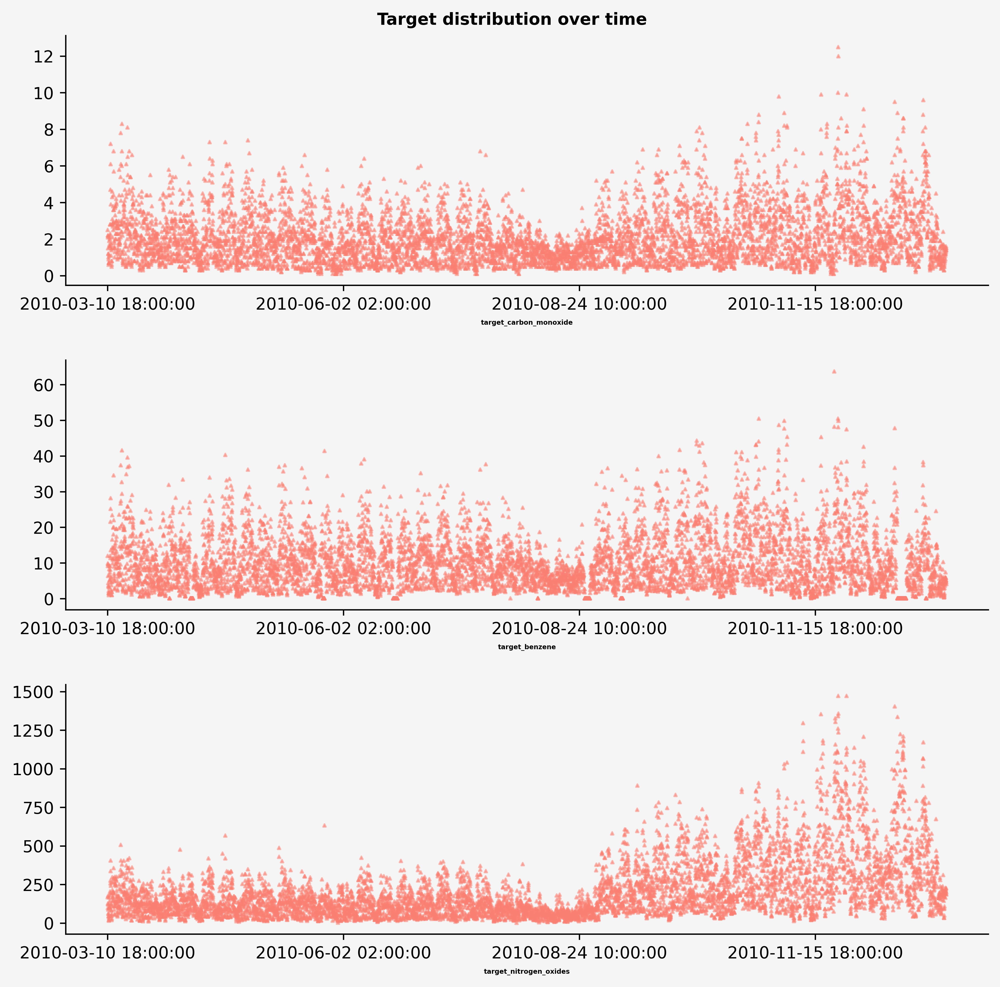

In [14]:
plt.rcParams['figure.dpi'] = 600
fig = plt.figure(figsize=(10, 10), facecolor='#f6f5f5')
gs = fig.add_gridspec(3, 1)
gs.update(wspace=0.3, hspace=0.3)

background_color = "#f6f5f5"
sns.set_palette('icefire')

run_no = 0
for row in range(0, 3):
    for col in range(0, 1):
        locals()["ax"+str(run_no)] = fig.add_subplot(gs[row, col])
        locals()["ax"+str(run_no)].set_facecolor(background_color)
        for s in ["top","right"]:
            locals()["ax"+str(run_no)].spines[s].set_visible(False)
        run_no += 1


run_no = 0
for target in targets:
    locals()["ax"+str(run_no)].scatter(x = train.date_time, y = train[target], s = 3, color='salmon', marker = '^', alpha = 0.5)
    locals()["ax"+str(run_no)].set_ylabel('')
    locals()["ax"+str(run_no)].set_xlabel(target, fontsize=4, fontweight='bold')
    locals()["ax"+str(run_no)].xaxis.set_major_locator(plt.MaxNLocator(5))
    run_no += 1
fig.text(0.5, 0.9, 'Target distribution over time', fontsize=10, ha='center', va='top', weight='bold')
plt.show()

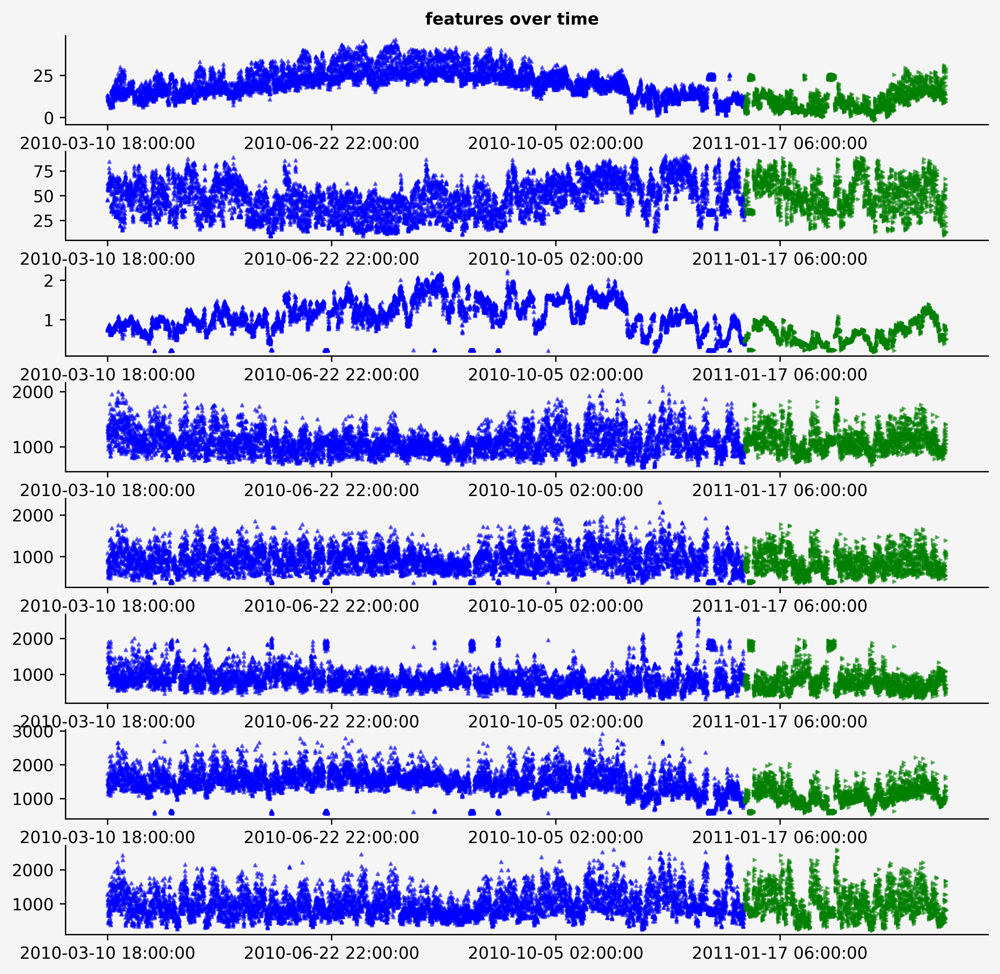

In [15]:
plt.rcParams['figure.dpi'] = 600
fig = plt.figure(figsize=(10, 10), facecolor='#f6f5f5')
gs = fig.add_gridspec(8, 1)
gs.update(wspace=0.3, hspace=0.3)

background_color = "#f6f5f5"
sns.set_palette('icefire')

run_no = 0
for row in range(0, 8):
    for col in range(0, 1):
        locals()["ax"+str(run_no)] = fig.add_subplot(gs[row, col])
        locals()["ax"+str(run_no)].set_facecolor(background_color)
        for s in ["top","right"]:
            locals()["ax"+str(run_no)].spines[s].set_visible(False)
        run_no += 1


run_no = 0
for feature in features:
    locals()["ax"+str(run_no)].scatter(x = train.date_time, y = train[feature], s = 3, color='blue', marker = '^', alpha = 0.5)
    locals()["ax"+str(run_no)].scatter(x = test.date_time, y = test[feature], s = 3, color='green', marker = '>', alpha = 0.5)
    locals()["ax"+str(run_no)].set_ylabel('')
    locals()["ax"+str(run_no)].xaxis.set_major_locator(plt.MaxNLocator(5))
    run_no += 1
fig.text(0.5, 0.9, 'features over time', fontsize=10, ha='center', va='top', weight='bold')
plt.show()

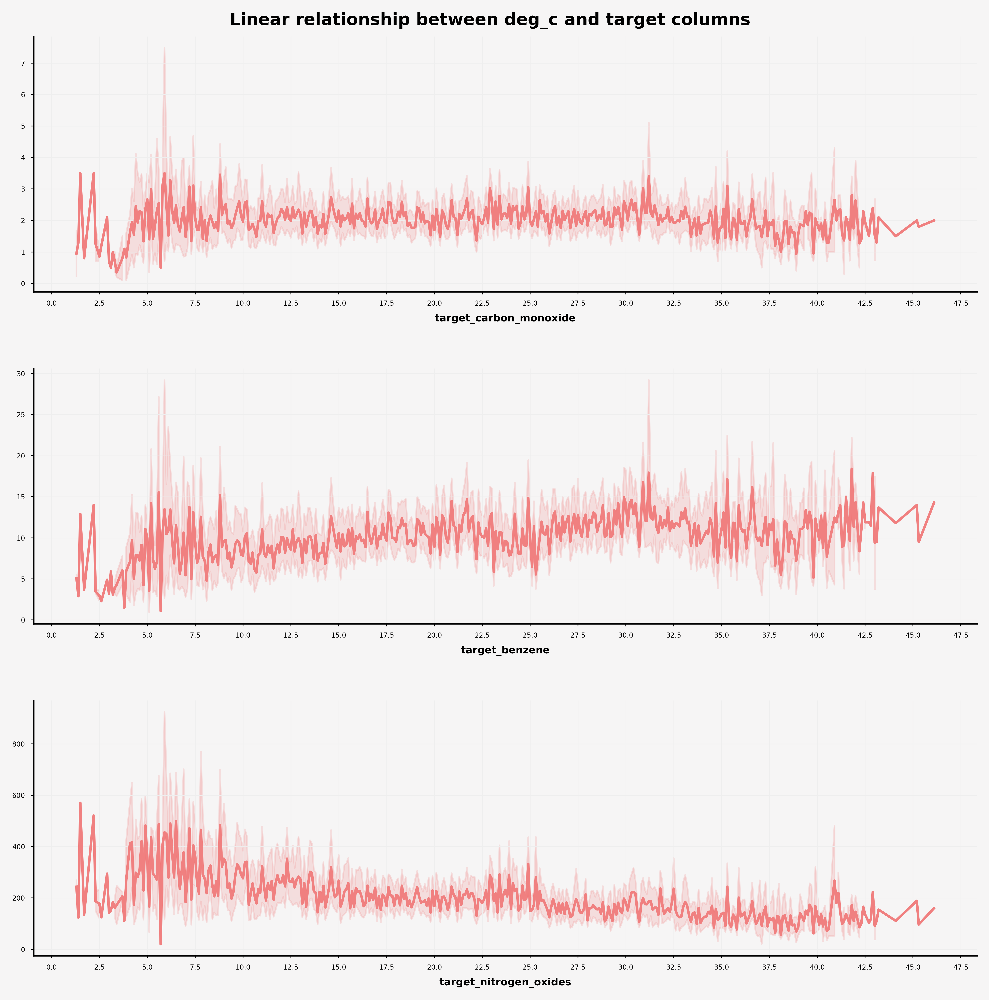

In [16]:
fig = plt.figure(figsize=(10, 10), facecolor='#f6f5f5')
gs = fig.add_gridspec(3, 1)
gs.update(wspace=0.3, hspace=0.3)

background_color = "#f6f5f5"
sns.set_palette('icefire')

run_no = 0
for row in range(0, 3):
    for col in range(0, 1):
        locals()["ax"+str(run_no)] = fig.add_subplot(gs[row, col])
        locals()["ax"+str(run_no)].set_facecolor(background_color)
        for s in ["top","right"]:
            locals()["ax"+str(run_no)].spines[s].set_visible(False)
        run_no += 1


run_no = 0
for target in targets:
    sns.lineplot(ax=locals()["ax"+str(run_no)],x = train.deg_C, y = train[target], color = 'lightcoral')
    locals()["ax"+str(run_no)].grid(which='major', axis='x', zorder=0, color='#EEEEEE', linewidth=0.4)
    locals()["ax"+str(run_no)].grid(which='major', axis='y', zorder=0, color='#EEEEEE', linewidth=0.4)
    locals()["ax"+str(run_no)].set_ylabel('')
    locals()["ax"+str(run_no)].set_xlabel(target, fontsize=6, fontweight='bold')
    locals()["ax"+str(run_no)].tick_params(labelsize=4, width=0.5, length=1.5)
    locals()["ax"+str(run_no)].xaxis.set_major_locator(plt.MaxNLocator(20))
    run_no += 1
fig.text(0.5, 0.9, 'Linear relationship between deg_c and target columns', fontsize=10, ha='center', va='top', weight='bold')
plt.show()

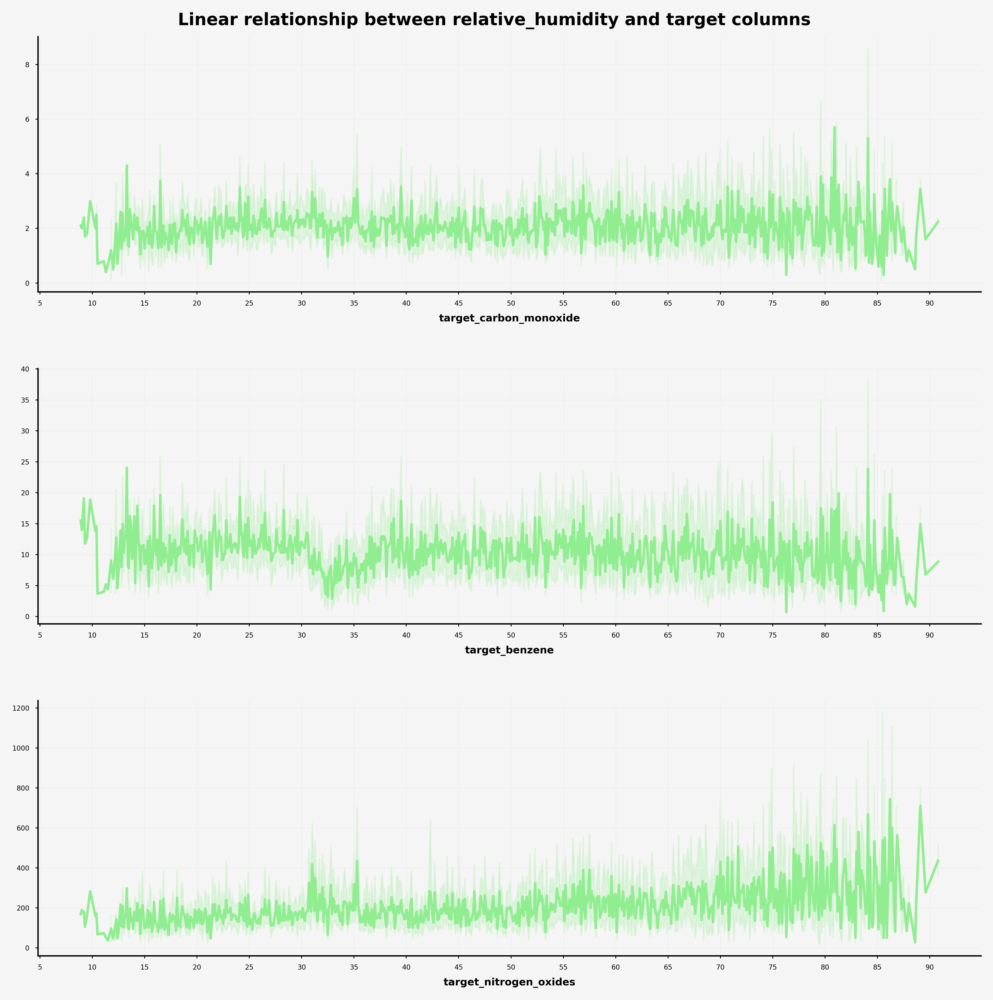

In [17]:
fig = plt.figure(figsize=(10, 10), facecolor='#f6f5f5')
gs = fig.add_gridspec(3, 1)
gs.update(wspace=0.3, hspace=0.3)

background_color = "#f6f5f5"
sns.set_palette('icefire')

run_no = 0
for row in range(0, 3):
    for col in range(0, 1):
        locals()["ax"+str(run_no)] = fig.add_subplot(gs[row, col])
        locals()["ax"+str(run_no)].set_facecolor(background_color)
        for s in ["top","right"]:
            locals()["ax"+str(run_no)].spines[s].set_visible(False)
        run_no += 1


run_no = 0
for target in targets:
    sns.lineplot(ax=locals()["ax"+str(run_no)],x = train.relative_humidity, y = train[target], color = 'lightgreen')
    locals()["ax"+str(run_no)].grid(which='major', axis='x', zorder=0, color='#EEEEEE', linewidth=0.4)
    locals()["ax"+str(run_no)].grid(which='major', axis='y', zorder=0, color='#EEEEEE', linewidth=0.4)
    locals()["ax"+str(run_no)].set_ylabel('')
    locals()["ax"+str(run_no)].set_xlabel(target, fontsize=6, fontweight='bold')
    locals()["ax"+str(run_no)].tick_params(labelsize=4, width=0.5, length=1.5)
    locals()["ax"+str(run_no)].xaxis.set_major_locator(plt.MaxNLocator(20))
    run_no += 1
fig.text(0.5, 0.9, 'Linear relationship between relative_humidity and target columns', fontsize=10, ha='center', va='top', weight='bold')
plt.show()

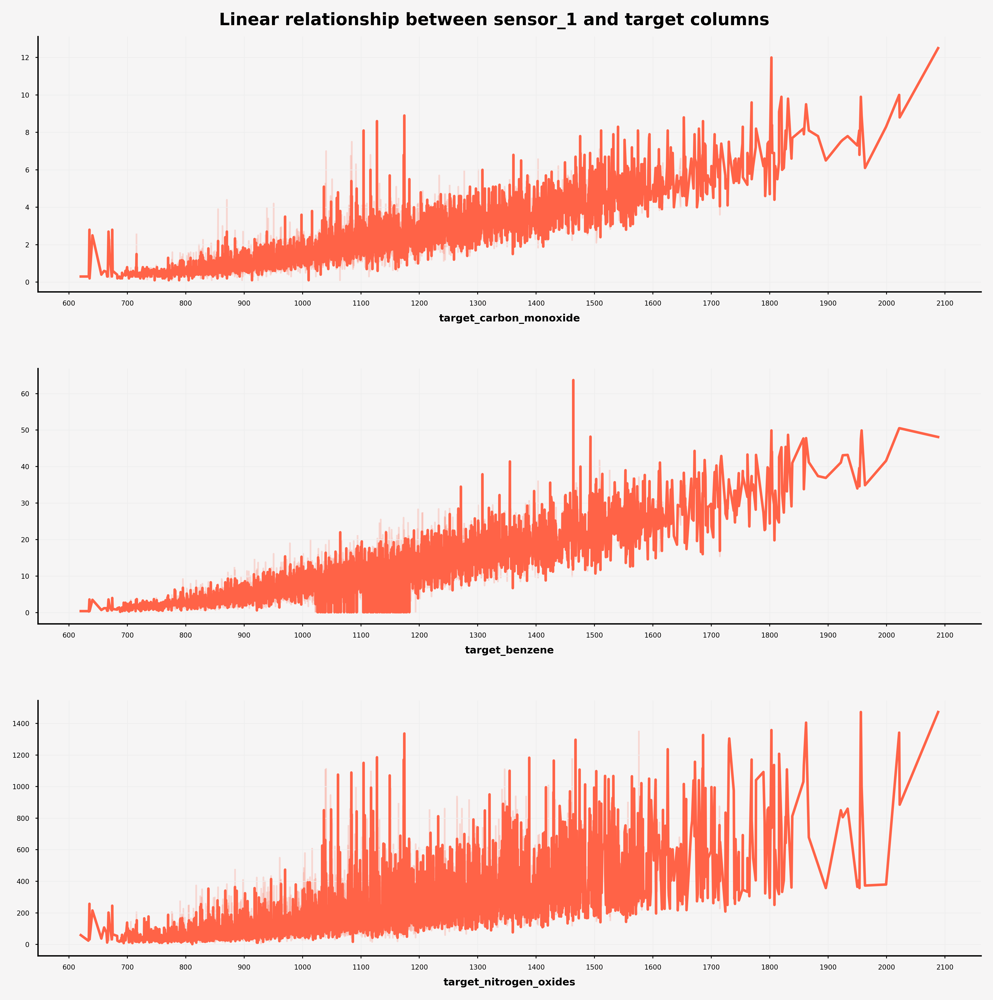

In [18]:
fig = plt.figure(figsize=(10, 10), facecolor='#f6f5f5')
gs = fig.add_gridspec(3, 1)
gs.update(wspace=0.3, hspace=0.3)

background_color = "#f6f5f5"
sns.set_palette('icefire')

run_no = 0
for row in range(0, 3):
    for col in range(0, 1):
        locals()["ax"+str(run_no)] = fig.add_subplot(gs[row, col])
        locals()["ax"+str(run_no)].set_facecolor(background_color)
        for s in ["top","right"]:
            locals()["ax"+str(run_no)].spines[s].set_visible(False)
        run_no += 1


run_no = 0
for target in targets:
    sns.lineplot(ax=locals()["ax"+str(run_no)],x = train.sensor_1, y = train[target], color = 'tomato')
    locals()["ax"+str(run_no)].grid(which='major', axis='x', zorder=0, color='#EEEEEE', linewidth=0.4)
    locals()["ax"+str(run_no)].grid(which='major', axis='y', zorder=0, color='#EEEEEE', linewidth=0.4)
    locals()["ax"+str(run_no)].set_ylabel('')
    locals()["ax"+str(run_no)].set_xlabel(target, fontsize=6, fontweight='bold')
    locals()["ax"+str(run_no)].tick_params(labelsize=4, width=0.5, length=1.5)
    locals()["ax"+str(run_no)].xaxis.set_major_locator(plt.MaxNLocator(20))
    run_no += 1
fig.text(0.5, 0.9, 'Linear relationship between sensor_1 and target columns', fontsize=10, ha='center', va='top', weight='bold')
plt.show()

In [ ]:
# relation among the targets
sns.pairplot(train[targets]);

In [ ]:
# relation among the features in train set
sns.pairplot(train[features]);

In [ ]:
# relation among the features in test set
sns.pairplot(test[features]);

## Heatmap of both datasets.

### Train set heatmap

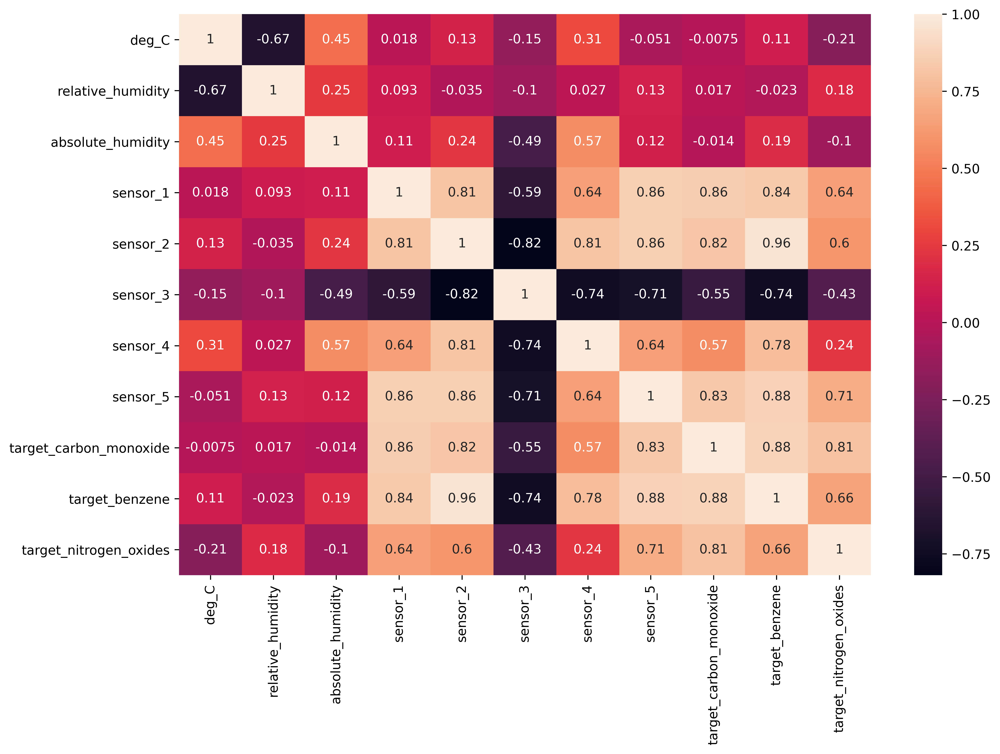

In [22]:
plt.figure(figsize = (12, 8))
corr_train = train.corr()
sns.heatmap(corr_train, annot = True);

### Test set heatmap

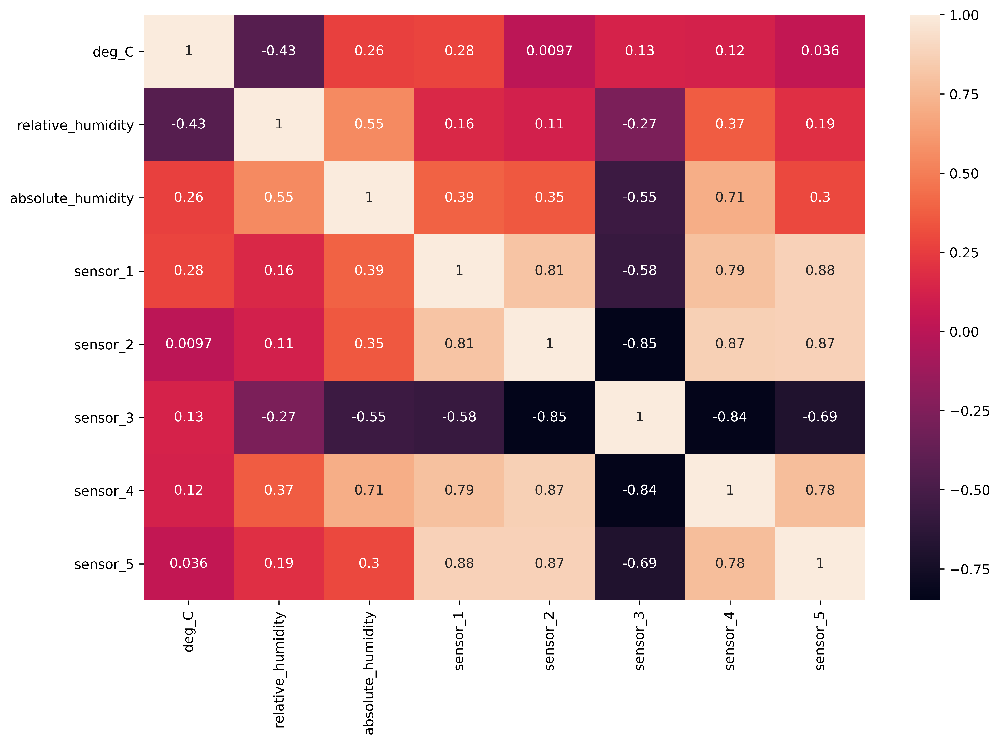

In [23]:
plt.figure(figsize = (12, 8))
corr_test = test.corr()
sns.heatmap(corr_test, annot = True);

# Feature Engineering

In [24]:
train['date_time'] = pd.to_datetime(train['date_time'], errors='coerce')
train.loc[:, 'weekofyear'] = train['date_time'].dt.weekofyear
train.loc[:, 'month'] = train['date_time'].dt.month
train.loc[:, 'hour'] = train['date_time'].dt.hour
train['fer_C'] = (train['deg_C']*(9/5)) + 32
train['kel_C'] = train['deg_C'] + 273.15
train['dew_point'] = train['deg_C'] - ((100 - train['relative_humidity'])/5)

In [25]:
test['date_time'] = pd.to_datetime(test['date_time'], errors='coerce')
test.loc[:, 'weekofyear'] = test['date_time'].dt.weekofyear
test.loc[:, 'month'] = test['date_time'].dt.month
test.loc[:, 'hour'] = test['date_time'].dt.hour
test['fer_C'] = (test['deg_C']*(9/5)) + 32
test['kel_C'] = test['deg_C'] + 273.15
test['dew_point'] = test['deg_C'] - ((100 - test['relative_humidity'])/5)

# Modeling using H2o AutoML

In [26]:
import h2o
from h2o.automl import H2OAutoML
h2o.init()

Checking whether there is an H2O instance running at http://localhost:54321 ..... not found.
Attempting to start a local H2O server...
  Java Version: openjdk version "11.0.10" 2021-01-19; OpenJDK Runtime Environment (build 11.0.10+9-Ubuntu-0ubuntu1.18.04); OpenJDK 64-Bit Server VM (build 11.0.10+9-Ubuntu-0ubuntu1.18.04, mixed mode, sharing)
  Starting server from /opt/conda/lib/python3.7/site-packages/h2o/backend/bin/h2o.jar
  Ice root: /tmp/tmpeitowf3x
  JVM stdout: /tmp/tmpeitowf3x/h2o_unknownUser_started_from_python.out
  JVM stderr: /tmp/tmpeitowf3x/h2o_unknownUser_started_from_python.err
  Server is running at http://127.0.0.1:54321
Connecting to H2O server at http://127.0.0.1:54321 ... successful.


H2O_cluster_uptime:,02 secs
H2O_cluster_timezone:,Etc/UTC
H2O_data_parsing_timezone:,UTC
H2O_cluster_version:,3.32.1.1
H2O_cluster_version_age:,3 months and 16 days !!!
H2O_cluster_name:,H2O_from_python_unknownUser_zs05uk
H2O_cluster_total_nodes:,1
H2O_cluster_free_memory:,4 Gb
H2O_cluster_total_cores:,4
H2O_cluster_allowed_cores:,4
H2O_cluster_status:,"accepting new members, healthy"


In [27]:
h2o_train = h2o.H2OFrame(train)
h2o_test = h2o.H2OFrame(test)

Parse progress: |█████████████████████████████████████████████████████████| 100%
Parse progress: |█████████████████████████████████████████████████████████| 100%


# Modeling

In [28]:
def h2oml(df, x, y, time = 60):
    df = df.drop(x, axis = 1)
    
    splits = df.split_frame(ratios = [0.8], seed = 1)
    x_train = splits[0]
    x_test = splits[1]
    
    aml = H2OAutoML(max_runtime_secs = time, seed = 1)
    aml.train(y = y, training_frame = x_train, leaderboard_frame = x_test)
    return aml
    

In [29]:
# trainning
aml1 = h2oml(h2o_train, ['target_benzene', 'target_nitrogen_oxides'], 'target_carbon_monoxide', 300)
aml2 = h2oml(h2o_train, ['target_carbon_monoxide', 'target_nitrogen_oxides'], 'target_benzene', 300)
aml3 = h2oml(h2o_train, ['target_carbon_monoxide', 'target_benzene'], 'target_nitrogen_oxides', 600)

AutoML progress: |████████████████████████████████████████████████████████| 100%
AutoML progress: |████████████████████████████████████████████████████████| 100%
AutoML progress: |████████████████████████████████████████████████████████| 100%


In [30]:
aml1.leaderboard.head()

model_id,mean_residual_deviance,rmse,mse,mae,rmsle
StackedEnsemble_AllModels_AutoML_20210712_101936,0.125742,0.354601,0.125742,0.227072,0.100244
StackedEnsemble_BestOfFamily_AutoML_20210712_101936,0.12753,0.357113,0.12753,0.231875,0.10154
XGBoost_3_AutoML_20210712_101936,0.137019,0.370161,0.137019,0.242889,0.105953
GBM_grid__1_AutoML_20210712_101936_model_2,0.137134,0.370317,0.137134,0.237267,0.104619
GBM_1_AutoML_20210712_101936,0.138168,0.371709,0.138168,0.239634,0.10694
GBM_grid__1_AutoML_20210712_101936_model_8,0.138796,0.372554,0.138796,0.243239,0.105946
GBM_3_AutoML_20210712_101936,0.138934,0.372738,0.138934,0.239023,0.104835
XGBoost_grid__1_AutoML_20210712_101936_model_14,0.139168,0.373052,0.139168,0.240023,0.108846
GBM_grid__1_AutoML_20210712_101936_model_5,0.139475,0.373464,0.139475,0.234095,0.103964
GBM_grid__1_AutoML_20210712_101936_model_6,0.140077,0.374269,0.140077,0.236794,0.104599


In [31]:
aml2.leaderboard.head()

model_id,mean_residual_deviance,rmse,mse,mae,rmsle
StackedEnsemble_AllModels_AutoML_20210712_102422,1.11614,1.05647,1.11614,0.727376,0.083414
StackedEnsemble_BestOfFamily_AutoML_20210712_102422,1.13967,1.06755,1.13967,0.735549,0.0864419
GBM_4_AutoML_20210712_102422,1.1986,1.09481,1.1986,0.756991,0.0862359
GBM_grid__1_AutoML_20210712_102422_model_6,1.20967,1.09985,1.20967,0.750779,0.0869058
GBM_grid__1_AutoML_20210712_102422_model_12,1.21857,1.10389,1.21857,0.750439,0.0859766
GBM_3_AutoML_20210712_102422,1.22094,1.10496,1.22094,0.758184,0.0850675
GBM_2_AutoML_20210712_102422,1.22241,1.10563,1.22241,0.757311,0.0850655
GBM_grid__1_AutoML_20210712_102422_model_5,1.24974,1.11792,1.24974,0.763781,0.0866308
GBM_1_AutoML_20210712_102422,1.25415,1.11989,1.25415,0.764607,0.0863388
GBM_grid__1_AutoML_20210712_102422_model_11,1.257,1.12116,1.257,0.755012,0.086082


In [32]:
aml3.leaderboard.head()

model_id,mean_residual_deviance,rmse,mse,mae,rmsle
StackedEnsemble_AllModels_AutoML_20210712_102907,2022.63,44.9737,2022.63,26.3353,0.198649
StackedEnsemble_BestOfFamily_AutoML_20210712_102907,2041.18,45.1794,2041.18,27.0358,0.204489
GBM_grid__1_AutoML_20210712_102907_model_6,2082.45,45.6338,2082.45,27.2891,0.212122
GBM_4_AutoML_20210712_102907,2122.35,46.069,2122.35,27.7795,0.211473
GBM_1_AutoML_20210712_102907,2128.47,46.1354,2128.47,27.7481,0.215633
GBM_grid__1_AutoML_20210712_102907_model_17,2175.89,46.6464,2175.89,27.3316,nan
GBM_grid__1_AutoML_20210712_102907_model_19,2189.37,46.7907,2189.37,27.7212,0.219526
GBM_grid__1_AutoML_20210712_102907_model_2,2199.21,46.8957,2199.21,27.6471,0.213412
GBM_grid__1_AutoML_20210712_102907_model_9,2200.26,46.9069,2200.26,27.851,0.221251
GBM_2_AutoML_20210712_102907,2209.52,47.0056,2209.52,28.0199,0.21483


In [33]:
# predicting
prediction1 = aml1.predict(h2o_test)
prediction2 = aml2.predict(h2o_test)
prediction3 = aml3.predict(h2o_test)

stackedensemble prediction progress: |████████████████████████████████████| 100%
stackedensemble prediction progress: |████████████████████████████████████| 100%
stackedensemble prediction progress: |████████████████████████████████████| 100%


In [34]:
# changing column names
prediction1.set_names(['target_carbon_monoxide'])
prediction2.set_names(['target_benzene'])
prediction3.set_names(['target_nitrogen_oxides']);

In [35]:
# converting to pandas column
pred1_data = h2o.as_list(prediction1)
pred2_data = h2o.as_list(prediction2)
pred3_data = h2o.as_list(prediction3)

### Creating submission file

In [36]:
submission = pd.concat([pd.DataFrame(sample_sub['date_time']),pred1_data, pred2_data, pred3_data], axis = 1)
submission.to_csv('submission_file.csv', index = False)

#### If you find it useful, don't forget Upvotting. Thanks